# Data processing

## I. Loading data

In [1]:
!pip install mne

In [1]:
import mne
file = "..\dataverse_files\h01.edf"
dataset_path = "..\dataverse_files"
manifest_path = "..\dataverse_files\MANIFEST.txt"

data = mne.io.read_raw_edf(file)
raw_data = data.get_data()

# you can get the metadata included in the file and a list of all channels:
info = data.info
channels = data.ch_names

Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...


In [2]:
print(len(raw_data.flatten()))
print(len(raw_data))
print(len(raw_data[0]))
print(len(raw_data)*len(raw_data[0]))

4393750
19
231250
4393750


In [3]:
info

<Info | 7 non-empty values
 bads: []
 ch_names: Fp2, F8, T4, T6, O2, Fp1, F7, T3, T5, O1, F4, C4, P4, F3, C3, ...
 chs: 19 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 125.0 Hz
 meas_date: 2003-06-23 16:14:37 UTC
 nchan: 19
 projs: []
 sfreq: 250.0 Hz
>

In [4]:
# Channels
print(channels)

['Fp2', 'F8', 'T4', 'T6', 'O2', 'Fp1', 'F7', 'T3', 'T5', 'O1', 'F4', 'C4', 'P4', 'F3', 'C3', 'P3', 'Fz', 'Cz', 'Pz']


In [5]:
# Descriptive statistics
data.describe()

<RawEDF | h01.edf, 19 x 231250 (925.0 s), ~23 kB, data not loaded>
ch  name  type  unit        min         Q1     median         Q3        max
 0  Fp2   EEG   µV      -190.06      -5.50       0.00       5.51     129.05
 1  F8    EEG   µV       -81.65      -5.65       0.00       5.81      79.97
 2  T4    EEG   µV       -33.79      -4.28       0.00       4.13      47.10
 3  T6    EEG   µV       -57.03      -7.18      -0.15       6.88      64.38
 4  O2    EEG   µV       -85.62     -11.47      -0.15      11.16      95.42
 5  Fp1   EEG   µV      -192.81      -4.28       0.00       4.28     141.29
 6  F7    EEG   µV       -92.35      -5.65       0.00       5.81      96.79
 7  T3    EEG   µV       -37.31      -4.43       0.00       4.44      45.87
 8  T5    EEG   µV       -55.50      -7.64      -0.15       7.34      77.98
 9  O1    EEG   µV       -87.15     -11.16      -0.15      10.71      94.96
10  F4    EEG   µV      -167.43      -2.90       0.00       3.06      51.99
11  C4    EEG   µV   

In [6]:
def load_dataset_as_mne(path):
    mne_dataset = []
    
    f = open(manifest_path, "r")
    
    for line in f.readlines():
        data = mne.io.read_raw_edf(file)
        mne_dataset.append(data)

    return mne_dataset

In [7]:
mne_dataset = load_dataset_as_mne(manifest_path)

Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Extracting EDF parameters from E:\Magisterka\projekt\dataverse_files\h01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Extracting EDF paramet

In [8]:
len(mne_dataset)

28

In [9]:
mne_dataset[0].get_data()

array([[2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
       [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
       [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
       ...,
       [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
       [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
       [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09]])

Using matplotlib as 2D backend.
Opening raw-browser...


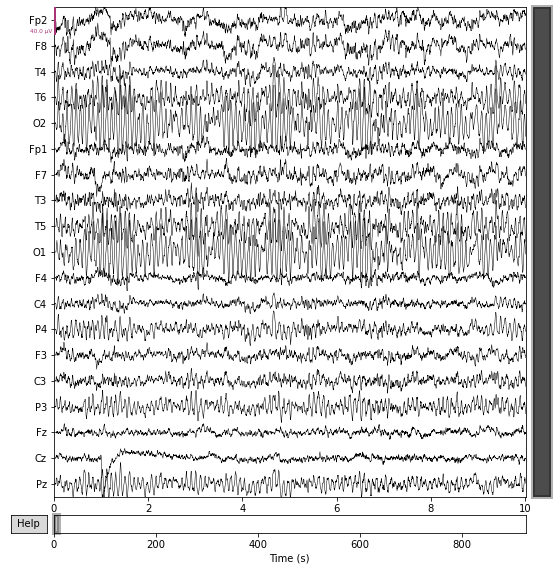

Figure(576x576)


In [10]:
print(mne_dataset[0].plot())

Effective window size : 8.192 (s)


<ipython-input-11-1e3c2881cff3>:1: RuntimeWarning: Channel locations not available. Disabling spatial colors.
  print(mne_dataset[0].plot_psd())


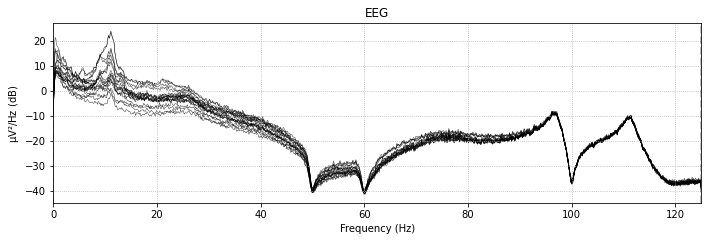

Figure(720x252)


In [11]:
print(mne_dataset[0].plot_psd())

In [12]:
def mne_to_raw_dataset(mne_dataset):
    return [mne_data.get_data() for mne_data in mne_dataset]

In [13]:
dataset = mne_to_raw_dataset(mne_dataset)

In [14]:
len(dataset)

28

In [15]:
dataset

[array([[2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        ...,
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09]]),
 array([[2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        ...,
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09]]),
 array([[2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
        [2.5e-09, 2.5e-09, 2.5e-09, ..., 2.5e-09, 2.5e-09, 2.5e-09],
    

Opening raw-browser...


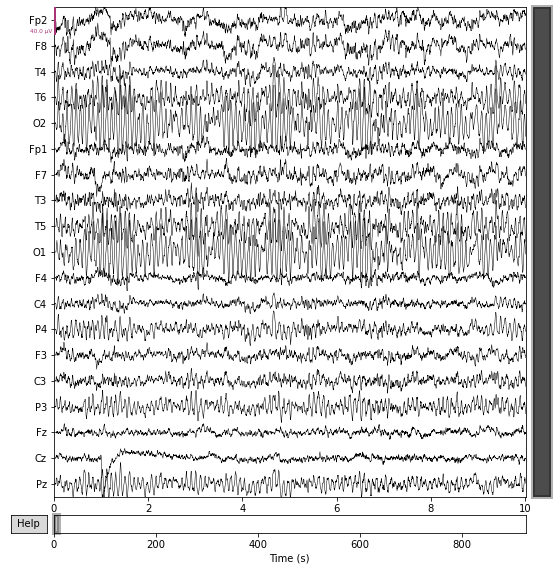

Figure(576x576)
Opening raw-browser...


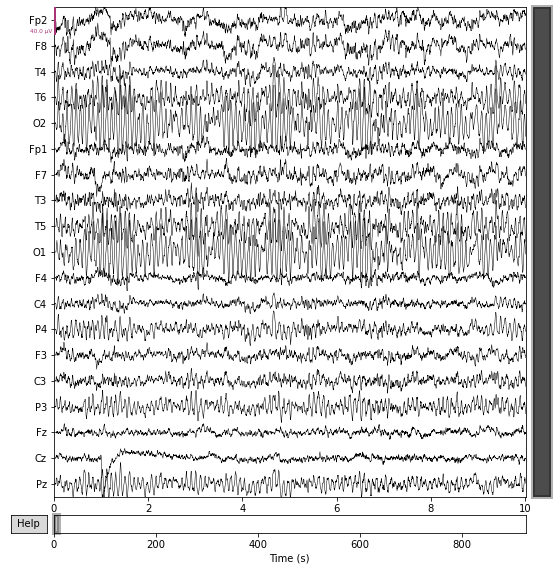

Figure(576x576)
Opening raw-browser...


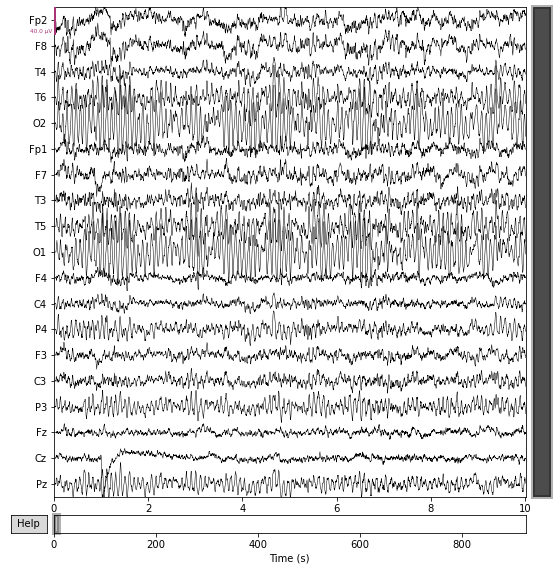

Figure(576x576)
Opening raw-browser...


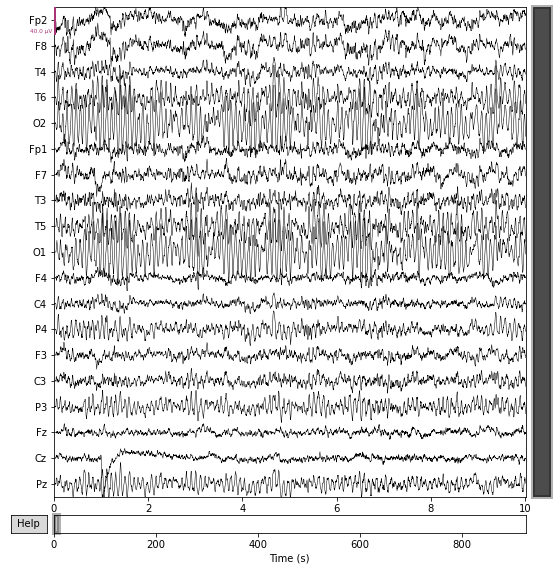

Figure(576x576)
Opening raw-browser...


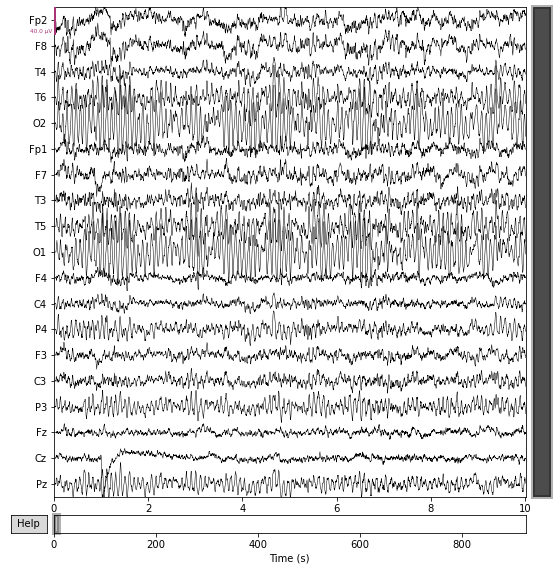

Figure(576x576)
Opening raw-browser...


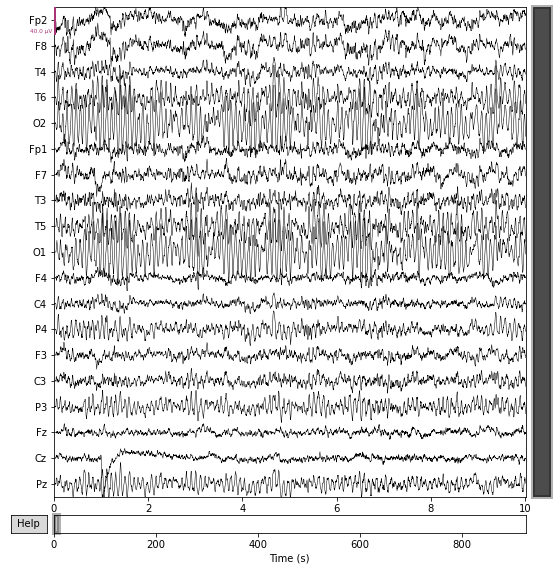

Figure(576x576)
Opening raw-browser...


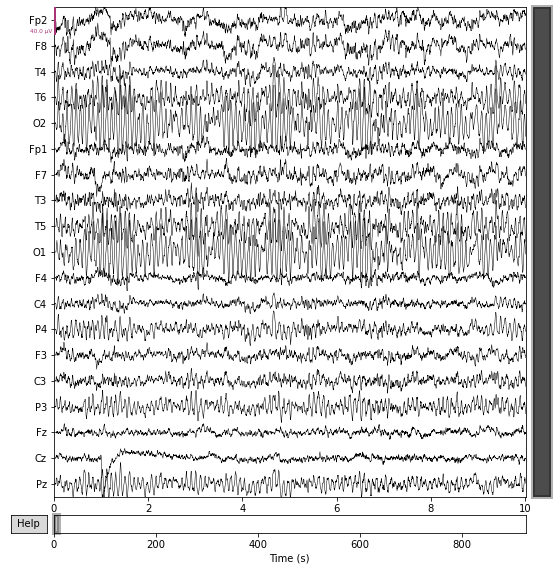

Figure(576x576)
Opening raw-browser...


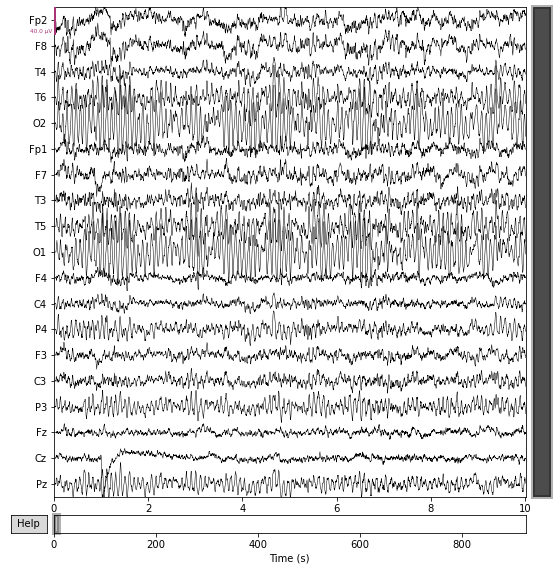

Figure(576x576)
Opening raw-browser...


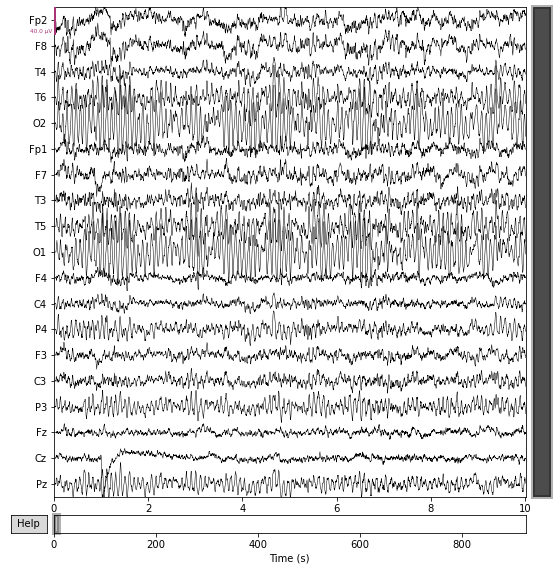

Figure(576x576)
Opening raw-browser...


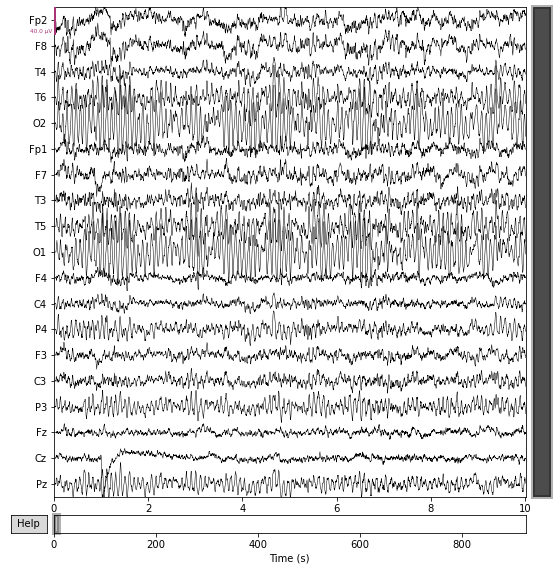

Figure(576x576)
Opening raw-browser...


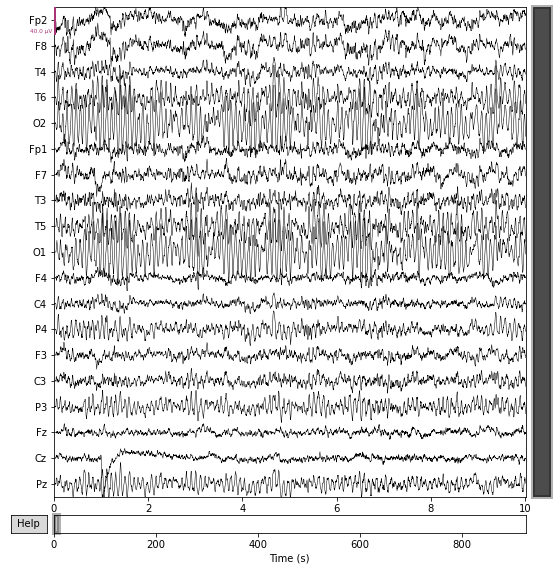

Figure(576x576)
Opening raw-browser...


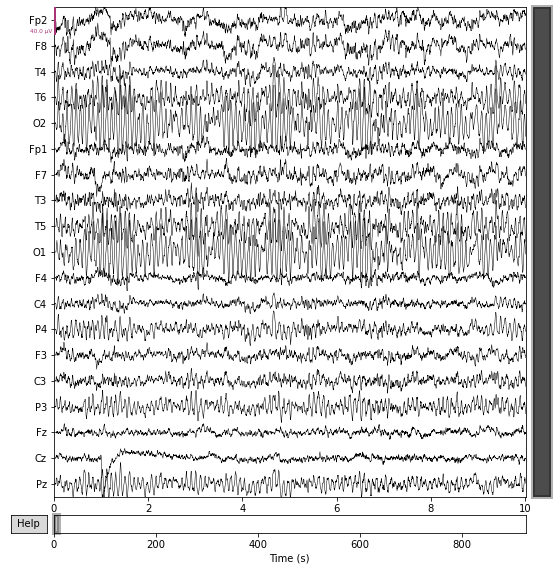

Figure(576x576)
Opening raw-browser...


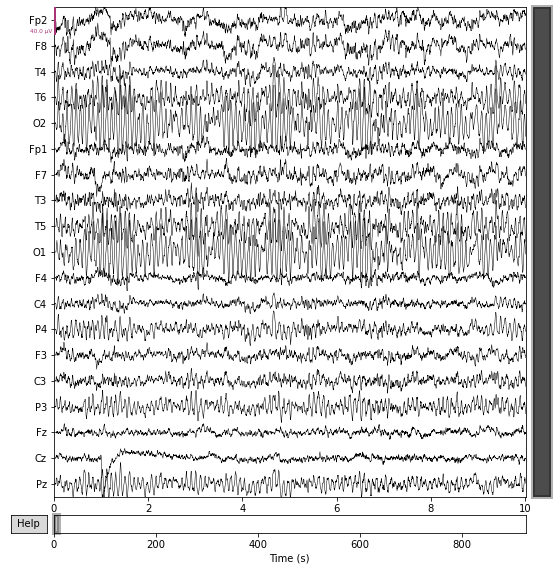

Figure(576x576)
Opening raw-browser...


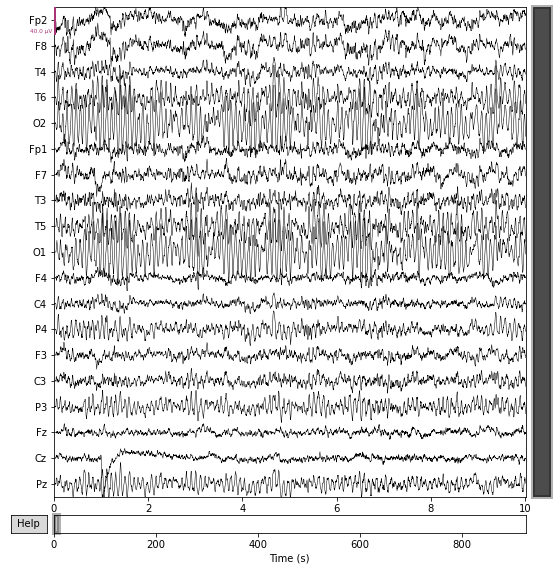

Figure(576x576)
Opening raw-browser...


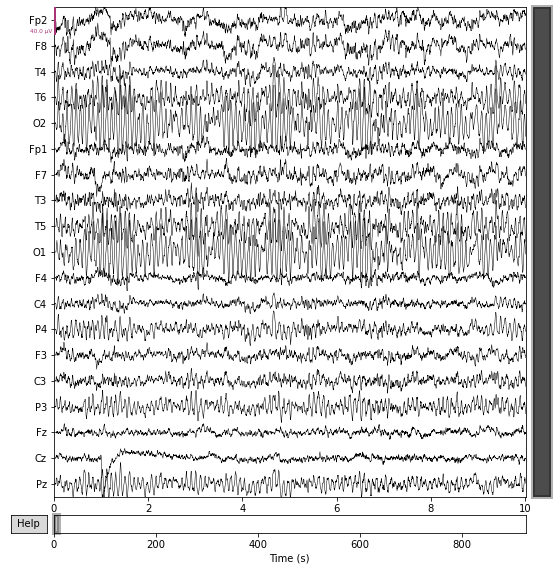

Figure(576x576)
Opening raw-browser...


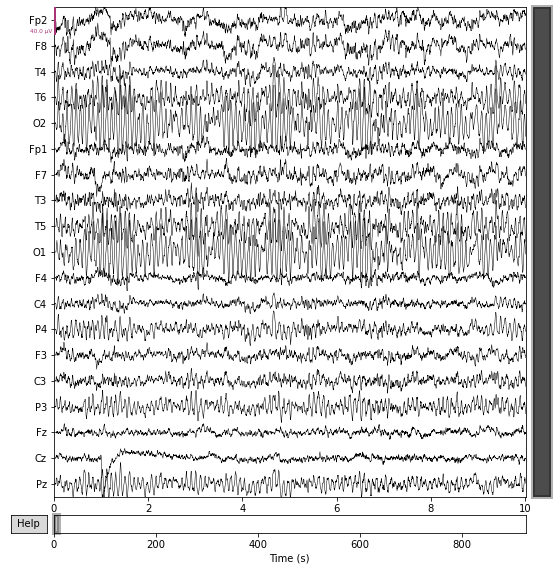

Figure(576x576)
Opening raw-browser...


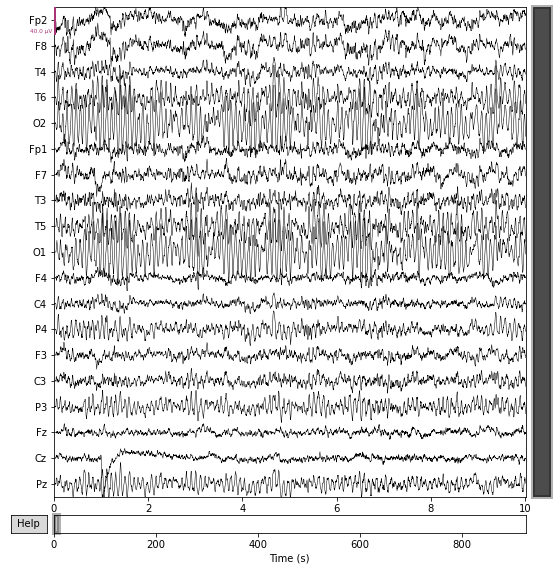

Figure(576x576)
Opening raw-browser...


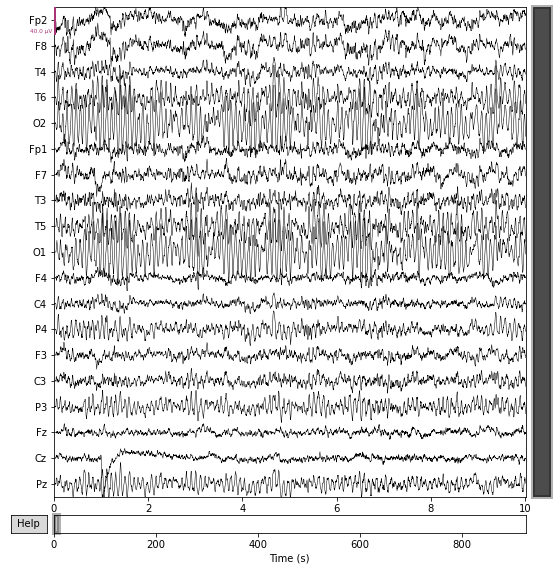

Figure(576x576)
Opening raw-browser...


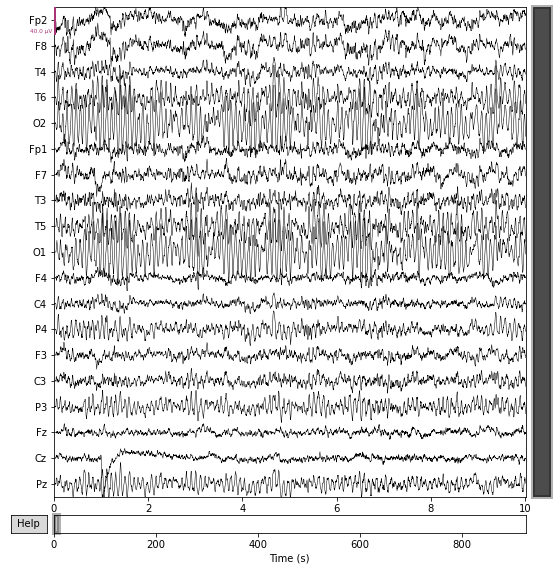

Figure(576x576)
Opening raw-browser...


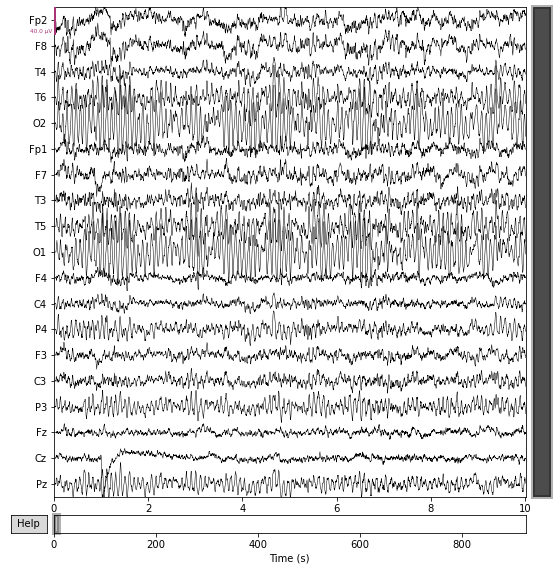

Figure(576x576)
Opening raw-browser...


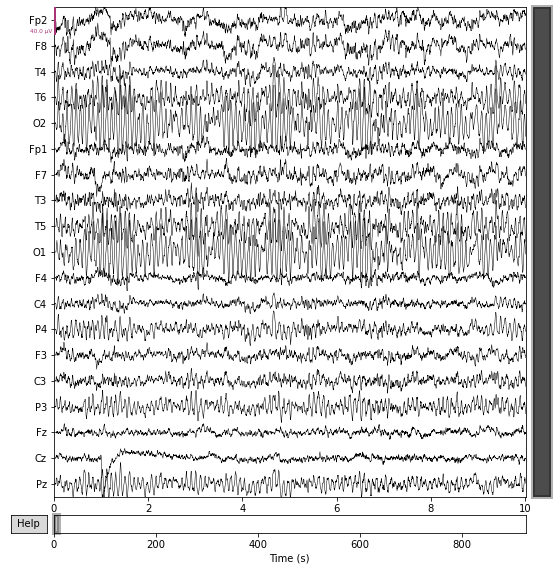

Figure(576x576)
Opening raw-browser...


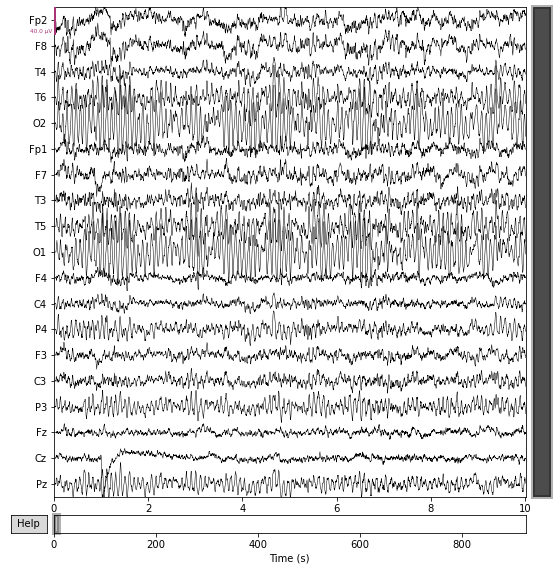

Figure(576x576)
Opening raw-browser...


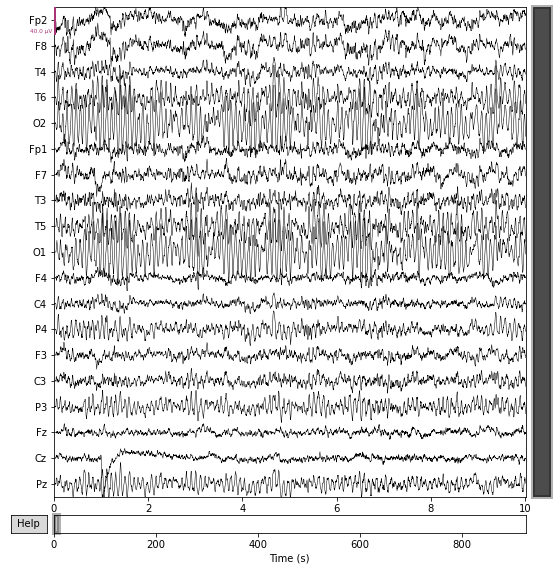

Figure(576x576)
Opening raw-browser...


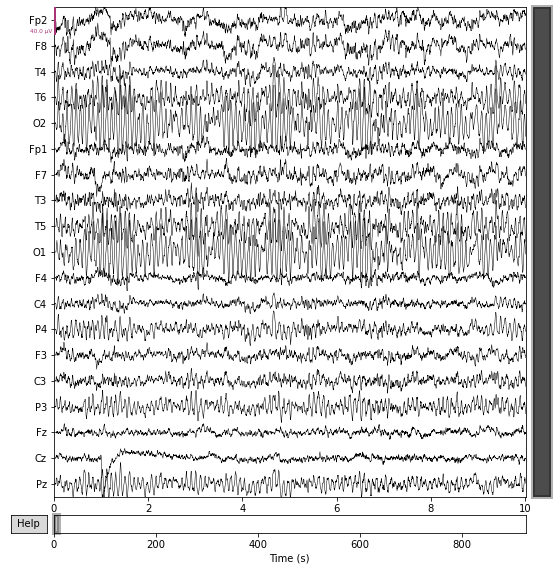

Figure(576x576)
Opening raw-browser...


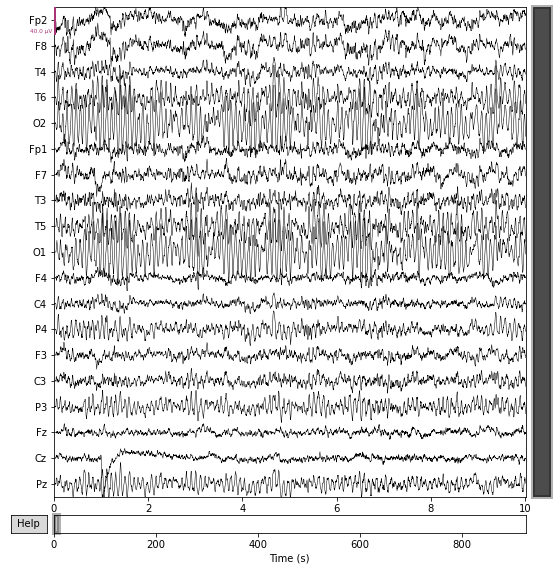

Figure(576x576)
Opening raw-browser...


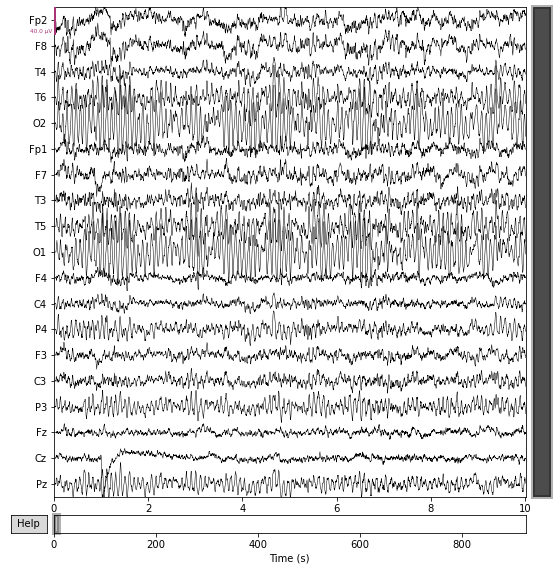

Figure(576x576)
Opening raw-browser...


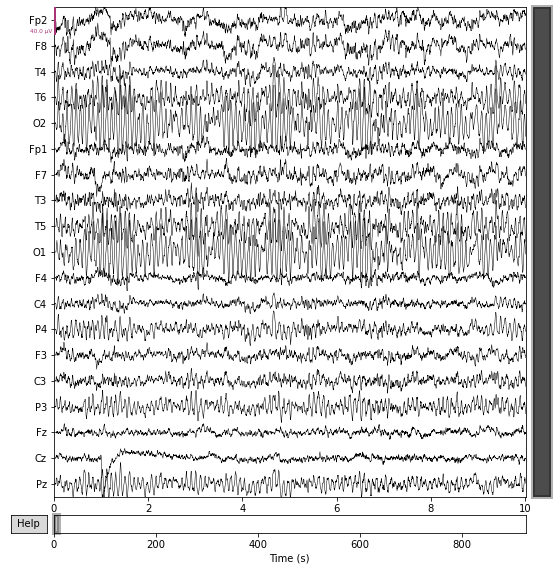

Figure(576x576)
Opening raw-browser...


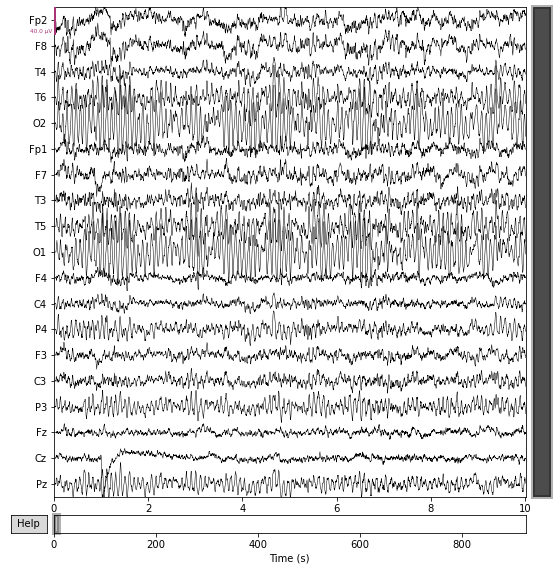

Figure(576x576)


In [17]:
for data in mne_dataset:
    print(data.plot())

In [18]:
mne_dataset[0].resample(256)

<RawEDF | h01.edf, 19 x 236800 (925.0 s), ~34.3 MB, data loaded>

Opening raw-browser...


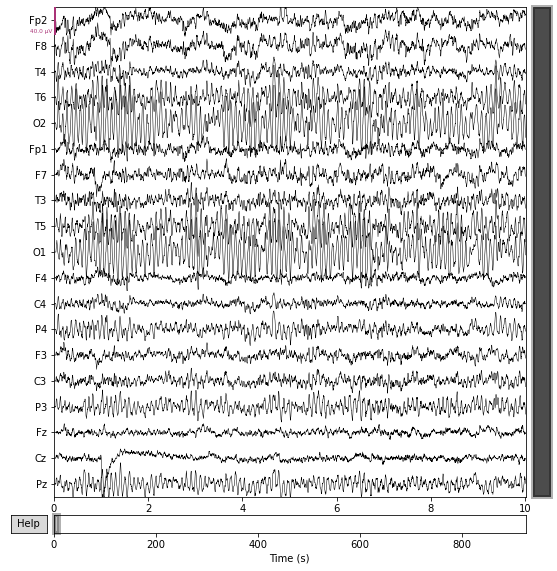

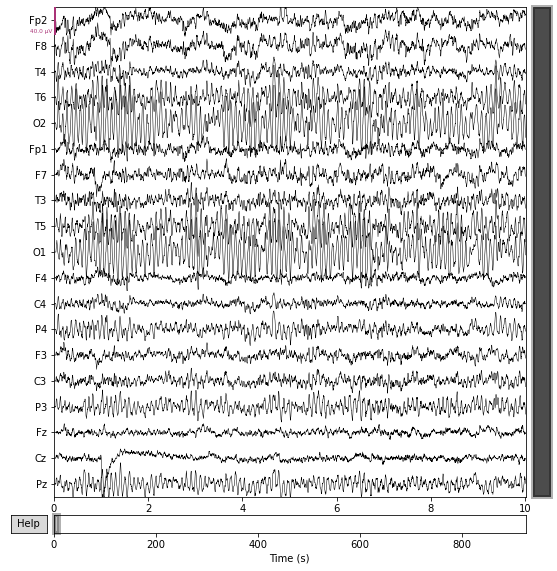

In [19]:
mne_dataset[0].plot()

In [20]:
mne_dataset[0].resample(128)

<RawEDF | h01.edf, 19 x 118400 (925.0 s), ~17.2 MB, data loaded>

Opening raw-browser...


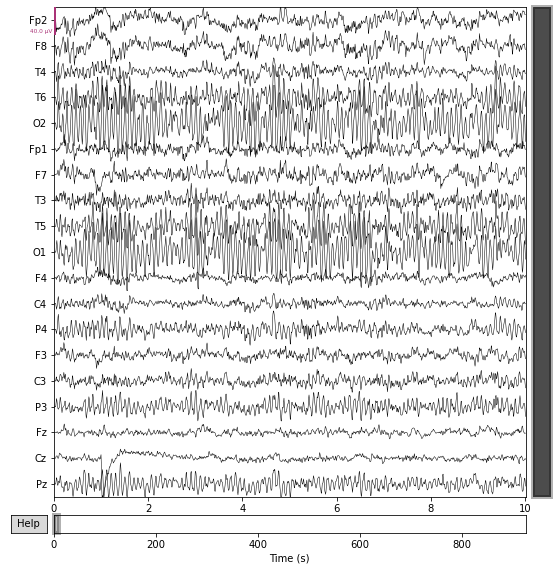

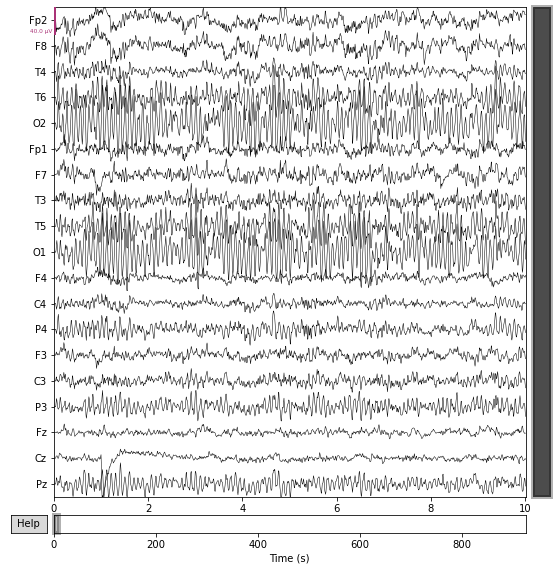

In [21]:
mne_dataset[0].plot()

In [20]:
mne_dataset[0].to_data_frame()

,time,Fp2,F8,T4,T6,O2,Fp1,F7,T3,T5,O1,F4,C4,P4,F3,C3,P3,Fz,Cz,Pz
0,0,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
1,4,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
2,8,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
3,12,0.461215,0.461215,0.308310,0.30831,0.155405,0.0025,0.0025,-0.150405,-0.150405,0.00250,0.0025,0.002500,0.0025,0.0025,-0.150405,-0.30331,0.0025,0.0025,-0.303310
4,16,0.461215,0.461215,0.461215,0.30831,0.155405,0.0025,0.0025,-0.150405,-0.150405,-0.30331,0.0025,0.155405,0.0025,0.0025,-0.150405,-0.30331,0.0025,0.0025,-0.150405
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
231245,924980,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
231246,924984,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
231247,924988,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
231248,924992,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500


In [17]:
mne_dataset[1]

<RawEDF | h01.edf, 19 x 231250 (925.0 s), ~23 kB, data not loaded>

In [24]:
924992/1000/60

15.416533333333332

In [25]:
# data segmentation

In [ ]:
data = mne.io.read_raw_edf(file)
raw_data = data.get_data()

In [28]:
len(raw_data)

19

In [32]:
len(raw_data[0])

231250

In [64]:
len(data)

231250

In [33]:
data.to_data_frame()

,time,Fp2,F8,T4,T6,O2,Fp1,F7,T3,T5,O1,F4,C4,P4,F3,C3,P3,Fz,Cz,Pz
0,0,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
1,4,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
2,8,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
3,12,0.461215,0.461215,0.308310,0.30831,0.155405,0.0025,0.0025,-0.150405,-0.150405,0.00250,0.0025,0.002500,0.0025,0.0025,-0.150405,-0.30331,0.0025,0.0025,-0.303310
4,16,0.461215,0.461215,0.461215,0.30831,0.155405,0.0025,0.0025,-0.150405,-0.150405,-0.30331,0.0025,0.155405,0.0025,0.0025,-0.150405,-0.30331,0.0025,0.0025,-0.150405
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
231245,924980,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
231246,924984,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
231247,924988,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500
231248,924992,0.002500,0.002500,0.002500,0.00250,0.002500,0.0025,0.0025,0.002500,0.002500,0.00250,0.0025,0.002500,0.0025,0.0025,0.002500,0.00250,0.0025,0.0025,0.002500


In [81]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

unprocessed_data = data.to_data_frame().values.tolist()

processed_data = scaler.fit(unprocessed_data).transform(unprocessed_data)
print(processed_data)

[[0.00000000e+00 5.95591759e-01 5.05203406e-01 ... 5.40983607e-01
  6.65071770e-01 4.69011725e-01]
 [4.32434302e-06 5.95591759e-01 5.05203406e-01 ... 5.40983607e-01
  6.65071770e-01 4.69011725e-01]
 [8.64868605e-06 5.95591759e-01 5.05203406e-01 ... 5.40983607e-01
  6.65071770e-01 4.69011725e-01]
 ...
 [9.99991351e-01 5.95591759e-01 5.05203406e-01 ... 5.40983607e-01
  6.65071770e-01 4.69011725e-01]
 [9.99995676e-01 5.95591759e-01 5.05203406e-01 ... 5.40983607e-01
  6.65071770e-01 4.69011725e-01]
 [1.00000000e+00 5.95591759e-01 5.05203406e-01 ... 5.40983607e-01
  6.65071770e-01 4.69011725e-01]]


In [82]:
sample_size = int(25*1000/4)
print(sample_size)
sample = []
samples = []
counter = 0;
for row in processed_data:
    sample.append(row)
    if counter > 0 and counter % sample_size == 0:
        samples.append(sample.copy())
        sample = []
        
    if counter + sample_size > len(data):
        break;
            
    counter += 1

print(len(samples))

6250
36


In [84]:
samples

[[array([0.        , 0.59559176, 0.50520341, 0.41776938, 0.4697733 ,
         0.47297297, 0.5771167 , 0.48827809, 0.44852941, 0.41580756,
         0.47858942, 0.7630662 , 0.50928382, 0.44013491, 0.38195991,
         0.4670913 , 0.45655877, 0.54098361, 0.66507177, 0.46901173]),
  array([4.32434302e-06, 5.95591759e-01, 5.05203406e-01, 4.17769376e-01,
         4.69773300e-01, 4.72972973e-01, 5.77116705e-01, 4.88278092e-01,
         4.48529412e-01, 4.15807560e-01, 4.78589421e-01, 7.63066202e-01,
         5.09283820e-01, 4.40134907e-01, 3.81959911e-01, 4.67091295e-01,
         4.56558773e-01, 5.40983607e-01, 6.65071770e-01, 4.69011725e-01]),
  array([8.64868605e-06, 5.95591759e-01, 5.05203406e-01, 4.17769376e-01,
         4.69773300e-01, 4.72972973e-01, 5.77116705e-01, 4.88278092e-01,
         4.48529412e-01, 4.15807560e-01, 4.78589421e-01, 7.63066202e-01,
         5.09283820e-01, 4.40134907e-01, 3.81959911e-01, 4.67091295e-01,
         4.56558773e-01, 5.40983607e-01, 6.65071770e-01, 4.6901

MinMaxScaler()
[9.24996000e+05 1.29054432e+02 7.99718847e+01 4.70972810e+01
 6.43755611e+01 9.54153031e+01 1.41286843e+02 9.67914493e+01
 4.58740400e+01 7.79841179e+01 9.49565877e+01 5.19902453e+01
 2.82899496e+01 5.07670042e+01 8.48648489e+01 3.83816884e+01
 4.87792375e+01 3.85345936e+01 3.21125780e+01 4.84734272e+01]
